In [1]:
import numpy as np
import pandas as pd
from scipy import signal
from scipy.linalg import eig
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
import particle_filters as pf

import pyhsmm
import pyhsmm.basic.distributions as distributions
from pyhsmm.util.general import rle

from pyhsmm.plugins.factorial.models import Factorial, FactorialComponentHSMM
from pyhsmm.internals.transitions import HDPHSMMTransitions
from pyhsmm.internals.initial_state import Uniform

import ast
import sys
import time

%matplotlib inline

In [14]:
# we load our parameters estimations
hyperparams_estimations = pd.read_table('parameters_estimations.tsv', index_col=[0,1,2])
hyperparams_estimations.sort_index(inplace=True)

# We load the temperature of Austin Texas
df = pd.read_table('../Data/temp_Austin_Texas_082016.txt',delim_whitespace=True)
col = np.array(['YR--MODAHRMN','TEMP'])
temperatures = df.loc[df['WBAN']==23907,col]
temperatures.columns = np.array(['date_time','temp'])
temperatures['temp'] = temperatures['temp'].apply(pd.to_numeric,errors='coerce')
temperatures['temp'] = (temperatures['temp'] - 32.) * 5.0/9.0
temperatures['date_time'] = temperatures['date_time'].apply(pd.to_datetime,errors='coerce',format='%Y%m%d%H%M')
temperatures.index = np.arange(temperatures.shape[0])
temperatures['temp'] = temperatures['temp'].astype(float).interpolate(method='linear').values

final_temperatures = pd.DataFrame(index=pd.DatetimeIndex(start='2016-08-01 00:00:00',end='2016-09-01 00:00:00',freq='1min'),columns=['temp'])
final_temperatures.loc[temperatures['date_time'],'temp'] = temperatures['temp'].values
final_temperatures['temp'] = final_temperatures['temp'].astype(float).interpolate(method='time')

class Power_simulator:
    priors = hyperparams_estimations
    #house = np.random.choice(list(set(hyperparams_estimations.index.get_level_values('house_id'))))
    house = 187
    temp_out = final_temperatures['temp'].values
    
    def __init__(self,T,lmbda,gamma):
        self.controlled_devices = ['air']
        self.uncontrolled_devices = ['refrigerator','furnace','dishwasher']
        # We choose a house at random
        #self.house = np.random.choice(list(set(self.priors.index.get_level_values('house_id'))))
        # We construct our models
        self.controlled_params = self.construct_controlled_params()
        self.model = self.construct_model()
        
        assert lmbda >= 0. and gamma >=0.
        self.lmbda = lmbda
        self.gamma = gamma
        self.t = 0
        self.nominal_power, self.uncontrolled_power = self.generate_aggregated_power(N=T)
        
        self.true_states = np.zeros(T)
        self.true_powers = np.zeros(T)
        self.temp_seq = np.zeros(T)
        
        
    def construct_controlled_params(self):
        controlled_params = {}
        for device in self.controlled_devices:
            modes = self.priors.loc[(device,self.house,slice(None))].index.get_level_values('mode')
            Nb_states = len(modes)
            controlled_params[device] = {'mu': np.zeros(Nb_states), 'sigmasq': np.zeros(Nb_states)}
            # We set up the params for each operating mode
            for mode in modes:
                # We set up the observations params
                obs_params = ast.literal_eval(self.priors.loc[(device,self.house,mode),'Obs params'])
                controlled_params[device]['mu'][int(mode.split(' ')[1])] = obs_params['theta_hat']
                controlled_params[device]['sigmasq'][int(mode.split(' ')[1])] = obs_params['sigmasq']
        return controlled_params
            
        
    def construct_model(self):
        # We construct a Factorial model for all devices 
        devices = self.controlled_devices + self.uncontrolled_devices
        component_model_list = []
        
        for device in devices:
            modes = self.priors.loc[(device,self.house,slice(None))].index.get_level_values('mode')
            Nb_states = len(modes)
            obs_distns = []
            dur_distns = []
            trans_mat = []
            # We set up the params for each operating mode
            for mode in modes:
                trans_mat.append(ast.literal_eval(self.priors.loc[(device,self.house,mode),'Trans params']))
                # We set up the observations params
                obs_params = ast.literal_eval(self.priors.loc[(device,self.house,mode),'Obs params'])
                theta_hat = obs_params['theta_hat']
                sigmasq = obs_params['sigmasq']
                gaussMixture = distributions.ScalarGaussianFixedvarMixture(mu_0_list=[theta_hat]*Nb_states,
                                                                   tausq_0_list=[sigmasq]*Nb_states,
                                                                   mixture_weights_0=[1./Nb_states]*Nb_states,
                                                                   sigmasq=sigmasq,
                                                                   mu=theta_hat)
                obs_distns.append(gaussMixture)

                # We set up the durations params
                dur_params = ast.literal_eval(self.priors.loc[(device,self.house,mode),'Dur params'])
                lambda_hat = dur_params['lambda_hat']
                p_hat = dur_params['p_hat']
                pi_hat = dur_params['pi_hat']
                r_hat = dur_params['r_hat']
                pnbMixture = distributions.MixtureDurationDistribution(  \
                    components=[distributions.PoissonDuration(alpha_0=1.,beta_0=1.,lmbda=lambda_hat),
                            distributions.NegativeBinomialFixedRDuration(alpha_0=0.5,beta_0=0.5,r=r_hat,p=p_hat)],
                    alpha_0=Nb_states,weights=np.array([pi_hat, 1-pi_hat]))
                dur_distns.append(pnbMixture)
        
            # We set up the transitions params
            trans_mat = np.array(trans_mat)
            trans_distn = HDPHSMMTransitions(state_dim=Nb_states,alpha=20.,gamma=20.,A=trans_mat,fullA=trans_mat,beta=[1./Nb_states]*Nb_states)

            # We set up the model for the device
            component_model = FactorialComponentHSMM(init_state_concentration=Nb_states,trans_distn=trans_distn,obs_distns=obs_distns,dur_distns=dur_distns)
            component_model_list.append(component_model)
    
        # We set up the Factorial model
        Factorial_model = Factorial(component_model_list)
        return Factorial_model
    
    def generate_aggregated_power(self,N=1):
        total_obs, all_obs, all_states = self.model.generate(N)
        uncontrolled_obs = all_obs[:,len(self.controlled_devices):].sum(1)
        return total_obs, uncontrolled_obs
    
    def generate_controlled_power(self,new_states,N=1):
        all_obs = np.zeros((N,len(self.controlled_devices)))
        for j, device in enumerate(self.controlled_devices):
            mu = self.controlled_params[device]['mu'][new_states[device]]
            sigmasq = self.controlled_params[device]['sigmasq'][new_states[device]]
            all_obs[:,j] = np.maximum(np.sqrt(sigmasq)*np.random.normal(size=N)+mu,0.).T
        total_obs = all_obs.sum(1)
        return np.double(total_obs)
    
    def measure_aggregated_power(self,new_states):
        self.true_states[self.t] = new_states['air']
        self.temp_seq[self.t] = self.prev_temp
        # We compute the aggregated power at time t
        self.true_powers[self.t] = self.generate_controlled_power(new_states)
        agg_power = self.uncontrolled_power[self.t] + self.true_powers[self.t]
        # We simulate the temperature at time t
        temperature = self.prev_temp - self.lmbda * (self.prev_temp - self.temp_out[self.t-1]) - self.gamma * new_states['air']
        # We increment time
        self.t += 1
        self.prev_temp = temperature
        # We send the aggregated power and the new temperature
        return agg_power, temperature
    
    def initial_measure(self,new_states,prev_temp):
        self.true_states[self.t] = new_states['air']
        self.temp_seq[self.t] = prev_temp
        # We compute the aggregated power at time t
        self.true_powers[self.t] = self.generate_controlled_power(new_states)
        agg_power = self.uncontrolled_power[self.t] + self.true_powers[self.t]
        # We simulate the temperature at time t
        temperature = prev_temp - self.lmbda * (prev_temp - self.temp_out[0]) - self.gamma * new_states['air']
        # We increment time
        self.t += 1
        self.prev_temp = temperature
        # We send the aggregated power and the new temperature
        return agg_power, temperature
    
    def plot_powers(self,ax_data):
        ax_data.plot(self.true_powers,label='true powers')
        ax_data.set_xlim((0,len(self.true_powers)))
        ax_data.legend(loc='best')
    
    def plot_states(self,ax_data,ax_states,estimated_states_seq): 
        # We plot a pcolormesh like the statesequence to show the difference between the prior statesq and the posterior statesq
        # Green is for same states and red is for different states
        diff = np.array(estimated_states_seq == self.true_states,dtype=int)
        state_colors = {0: 0, 1: 1}
        stateseq_norep, durations = rle(diff)
        datamin, datamax = 0., 1.
        x, y = np.hstack((0,durations.cumsum())), np.array([datamin,datamax])
        C = np.atleast_2d([state_colors[state] for state in stateseq_norep])

        ax_states.pcolormesh(x,y,C,vmin=0,vmax=1,alpha=0.3,cmap='RdYlGn')
        ax_states.set_ylim((datamin,datamax))
        ax_states.set_xlim((0,len(diff)))
        ax_states.set_yticks([])
        ax_states.set_title('differences')
        
        # We plot the data with the estimated one in red dashes 
        mu = self.controlled_params['air']['mu']
        powers_hat = np.array([mu[int(state)] for state in estimated_states_seq])
            
        ax_data.plot(self.true_powers,label='true powers')
        ax_data.plot(powers_hat,'r--',label='estimated powers')
        ax_data.set_xlim((0,len(self.true_powers)))
        ax_data.legend(loc='best')
        
        return float(np.sum(diff))/len(diff)
    
    def plot_temp(self,theta_max,theta_min,ax_data):              
        # We plot the temperature and the bounds (theta_min,theta_max)
        T = len(self.temp_seq)
        in_bounds = np.array([1. if temp>=theta_min and temp<=theta_max else 0. for temp in self.temp_seq])
            
        ax_data.plot(self.temp_seq,color='green',label='temperature')
        ax_data.plot(self.temp_out[:T],color='black',label='temperature out')
        ax_data.plot((0, T-1), (theta_max, theta_max),'r--',label='theta_max')
        ax_data.plot((0, T-1), (theta_min, theta_min),'b--',label='theta_min')
        ax_data.set_xlim((0,T-1))
        ax_data.legend(loc='best')
        
        return np.sum(in_bounds)/T
    
    def plot_onlytemp(self,ax_data):              
        # We plot only the temperature 
        T = len(self.temp_seq)   
        p = ax_data.plot(self.temp_seq,color='blue',label='temperature')
        ax_data.set_xlim((0,T-1))
    

In [15]:
disagg_priors = pd.read_table('priors.tsv', index_col=[0,1,2])
disagg_priors.sort_index(inplace=True)

HC = pd.read_table('houses_classes.tsv', index_col=[0])
HC.sort_index(inplace=True)

class temp_to_state:
    def __init__(self,intervals):
        self.intervals = intervals
    def fit(self,t):
        for j, interval in enumerate(intervals):
            if t>=interval[0] and t<interval[1]:
                return j
        return None
    
class Transition_model:
    
    def __init__(self,U_BA,theta_max,theta_min,theta_on,kappa,rho,**args):
        self.U = U_BA # Vector of states power consumption (U[0] consumption when OFF and U[1] consumption when ON)
        self.theta_max = theta_max
        self.theta_min = theta_min
        self.theta_on = theta_on
        self.kappa = kappa
        self.rho = rho
        
    def cdf_on(self,theta):
        if theta >= self.theta_max:
            return 1.
        elif theta < self.theta_min:
            return 0.
        else:
            return (1-self.rho)*np.power(np.maximum(0,(theta-self.theta_on))/(self.theta_max-self.theta_on),self.kappa)


    def cdf_off(self,theta):
        if theta >= self.theta_max:
            return 1.
        elif theta < self.theta_min:
            return 0.
        else:
            return 1.-self.cdf_on(self.theta_max+self.theta_min-theta)
    
    def p_on(self,theta_current,theta_previous):
        if theta_previous >= self.theta_max:
            return 1.
        elif theta_previous <= self.theta_min:
                return 0.
        else:
            return np.maximum(0,self.cdf_on(theta_current)-self.cdf_on(theta_previous))/(1.-self.cdf_on(theta_previous))
        
    def p_off(self,theta_current,theta_previous):
        if theta_previous <= self.theta_min:
            return 1.
        elif theta_previous >= self.theta_max:
                return 0.
        else:
            return np.maximum(0,self.cdf_off(theta_previous)-self.cdf_off(theta_current))/self.cdf_off(theta_previous)
    
    def p_on_zeta(self,zeta,theta_current,theta_previous):
        if zeta == 0.:
            return self.p_on(theta_current,theta_previous)
        else:
            if theta_previous >= self.theta_max:
                return 1.
            elif theta_previous <= self.theta_min:
                return 0.
            else:
                return self.p_on(theta_current,theta_previous)*np.exp(zeta*self.U[1])/(self.p_on(theta_current,theta_previous)*np.exp(zeta*self.U[1])+(1.-self.p_on(theta_current,theta_previous))*np.exp(zeta*self.U[0]))
    
    def p_off_zeta(self,zeta,theta_current,theta_previous):
        if zeta == 0.:
            return self.p_off(theta_current,theta_previous)
        else:
            if theta_previous <= self.theta_min:
                return 1.
            elif theta_previous >= self.theta_max:
                return 0.
            else:
                return self.p_off(theta_current,theta_previous)*np.exp(zeta*self.U[0])/(self.p_off(theta_current,theta_previous)*np.exp(zeta*self.U[0])+(1.-self.p_off(theta_current,theta_previous))*np.exp(zeta*self.U[1]))
    

class Disaggregation_system:
    SIR_priors = disagg_priors
    houses_classes = HC
    
    def __init__(self,Nb_particles,T,trans_model,lmbda,gamma,**args):
        # The model to compute the transition probabilities for the device state
        self.trans_model = trans_model
        
        self.theta_hist = np.zeros(2,dtype=np.double) # vector that gives the previous theta (theta_hist[0]) and the current one (theta_hist[1])
        self.theta_hist[0] = np.mean([theta_max, theta_min])
        self.state = np.random.choice([0,1]) # The operating mode for the device, 0: OFF, 1: ON
        self.estimated_states_seq = np.zeros(T)
        
        # Associed power simulator 
        self.PS = Power_simulator(T,lmbda,gamma)
        self.agg_power, self.theta_hist[1] = self.PS.initial_measure({'air': self.state},self.theta_hist[0])
        
        # Disaggregation algorithm
        self.disaggregation_algo = self.construct_disagg_model(Nb_particles)
        
    def construct_disagg_model(self,Nb_particles):
        devices = self.PS.controlled_devices + self.PS.uncontrolled_devices
        classes = ['class {}'.format(c) for c in self.houses_classes.loc[self.PS.house,:].values[:4]]
        params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
        L = {device: 1 for device in devices}
        for device, device_class in zip(devices,classes):
            list_modes = self.SIR_priors.loc[(device,device_class,slice(None)),].index.get_level_values(self.SIR_priors.index.names[2])
            Nb_states = len(list_modes)
            params['Nb_states'].append(Nb_states*L[device])
            params['alpha'].append(np.repeat(1./(Nb_states*L[device]),Nb_states*L[device]))
            params['mu_0'].append(np.repeat([ast.literal_eval(self.SIR_priors.loc[(device,device_class,mode),'Obs params'])['mu_0'] for mode in list_modes],L[device]))
            params['tausq_0'].append(np.repeat([ast.literal_eval(self.SIR_priors.loc[(device,device_class,mode),'Obs params'])['tausq_0'] for mode in list_modes],L[device]))
            params['sigmasq'].append(np.repeat([ast.literal_eval(self.SIR_priors.loc[(device,device_class,mode),'Obs params'])['sigmasq'] for mode in list_modes],L[device]))
        
        disagg_model = pf.SIR_Factorial_HMM(N=Nb_particles,buffer_length=5,Nb_chains=4,**params)
        return disagg_model
        
    def disaggregate_power(self):
        verbose = 0
        self.disaggregation_algo.add_data(self.agg_power)
        estimated_states, _estimated_transition_mat, _estimated_theta = self.disaggregation_algo.next_step(verbose)
        self.state = estimated_states[0]
        self.estimated_states_seq[self.PS.t-1] = self.state
        
    def initial_fit(self,zeta):
        self.disaggregation_algo.add_data(self.agg_power)
        estimated_states, _estimated_transition_mat, _estimated_theta = self.disaggregation_algo.initial_step()
        self.state = estimated_states[0]
        self.estimated_states_seq[0] = self.state
        
        if self.state == 0:
            if np.random.uniform() <= self.trans_model.p_on_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 1
        elif self.state == 1:
            if np.random.uniform() <= self.trans_model.p_off_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 0
        
        self.theta_hist[0] = self.theta_hist[1]
        self.agg_power, self.theta_hist[1] = self.PS.measure_aggregated_power({'air': self.state})
        
    
    def fit(self,zeta):
        self.disaggregate_power()
        
        if self.state == 0:
            if np.random.uniform() <= self.trans_model.p_on_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 1
        elif self.state == 1:
            if np.random.uniform() <= self.trans_model.p_off_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 0
                
        self.theta_hist[0] = self.theta_hist[1]
        self.agg_power, self.theta_hist[1] = self.PS.measure_aggregated_power({'air': self.state})
        
    def final_fit(self):
        self.disaggregate_power()
        
    def plot_states(self,ax_data,ax_states):
        return self.PS.plot_states(ax_data,ax_states,self.estimated_states_seq)
    
    def plot_temp(self,ax_data):
        return self.PS.plot_temp(self.trans_model.theta_max,self.trans_model.theta_min,ax_data)
    
class Transition_system:
    
    def __init__(self,T,trans_model,lmbda,gamma,**args):
        # The model to compute the transition probabilities for the device state
        self.trans_model = trans_model
        
        self.theta_hist = np.zeros(2,dtype=np.double) # vector that gives the previous theta (theta_hist[0]) and the current one (theta_hist[1])
        self.theta_hist[0] = np.mean([theta_max, theta_min])
        self.state = np.random.choice([0,1]) # The operating mode for the device, 0: OFF, 1: ON
        self.true_states_seq = np.zeros(T)
        
        # Associed power simulator 
        self.PS = Power_simulator(T,lmbda,gamma)
        self.agg_power, self.theta_hist[1] = self.PS.initial_measure({'air': self.state},self.theta_hist[0])
        
    def initial_fit(self,zeta):
        self.fit(zeta)
    
    def fit(self,zeta):    
        self.true_states_seq[self.PS.t-1] = self.state
        if self.state == 0:
            if np.random.uniform() <= self.trans_model.p_on_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 1
        elif self.state == 1:
            if np.random.uniform() <= self.trans_model.p_off_zeta(zeta,self.theta_hist[1],self.theta_hist[0]):
                self.state = 0
                
        self.theta_hist[0] = self.theta_hist[1]
        self.agg_power, self.theta_hist[1] = self.PS.measure_aggregated_power({'air': self.state})
        
    def final_fit(self):
        self.true_states_seq[self.PS.t-1] = self.state
    
    def plot_temp(self,ax_data):
        return self.PS.plot_temp(self.trans_model.theta_max,self.trans_model.theta_min,ax_data)
    
    def plot_behavior(self):
        fig, ax = plt.subplots(1,1,figsize=(15,5))  
        # We plot a pcolormesh fo the statesequence 
        # Yellow is ON and white is OFF
        state_colors = {0: 1., 1: 0.8}
        stateseq_norep, durations = rle(self.true_states_seq)
        datamin, datamax = 16.,24.
        x, y = np.hstack((0,durations.cumsum())), np.array([datamin,datamax])
        C = np.atleast_2d([state_colors[state] for state in stateseq_norep])

        pc = ax.pcolormesh(x,y,C,vmin=0,vmax=1,alpha=1.,cmap='hot')
        ax.set_ylim((datamin, datamax))
        ax.set_xlim((0,len(self.true_states_seq)))
        
        # We plot the temperature
        self.PS.plot_onlytemp(ax)   
        p = mlines.Line2D([], [], color='blue', linestyle='-',label='temperature')
        ax.legend([pc, p], ['device ON','temperature'],handler_map={pc: pcolormesh_Handler()},loc='best')
        
class pcolormesh_Handler(object):
    def legend_artist(self, legend, orig_handle, fontsize, handlebox):
        x0, y0 = handlebox.xdescent, handlebox.ydescent
        width, height = handlebox.width, handlebox.height
        patch = mpatches.Rectangle([x0, y0], width, height, facecolor='yellow',transform=handlebox.get_transform())
        handlebox.add_artist(patch)
        return patch

In [38]:
df = pd.read_table('../Data/temp_Austin_Texas_082016.txt',delim_whitespace=True)
col = np.array(['YR--MODAHRMN','TEMP'])
temperatures = df.loc[df['WBAN']==23907,col]
temperatures.columns = np.array(['date_time','temp'])
temperatures['temp'] = temperatures['temp'].apply(pd.to_numeric,errors='coerce')
temperatures['temp'] = (temperatures['temp'] - 32.) * 5.0/9.0
temperatures['date_time'] = temperatures['date_time'].apply(pd.to_datetime,errors='coerce',format='%Y%m%d%H%M')
temperatures.index = np.arange(temperatures.shape[0])

final_temperatures = pd.DataFrame(index=pd.DatetimeIndex(start='2016-08-01 00:00:00',end='2016-09-01 00:00:00',freq='1min'),columns=['temp'])
final_temperatures.loc[temperatures['date_time'],'temp'] = temperatures['temp'].values
final_temperatures['temp'] = final_temperatures['temp'].astype(float).interpolate(method='time')

In [130]:
temperatures

,date_time,temp
0,2016-08-01 00:00:00,32.777778
1,2016-08-01 00:05:00,32.777778
2,2016-08-01 00:10:00,32.777778
3,2016-08-01 00:15:00,32.222222
4,2016-08-01 00:20:00,32.222222
5,2016-08-01 00:25:00,32.222222
6,2016-08-01 00:30:00,32.222222
7,2016-08-01 00:35:00,32.222222
8,2016-08-01 00:40:00,32.222222
9,2016-08-01 00:45:00,31.666667


In [4]:
temperatures['temp'].mean()

26.896128493638866

In [131]:
temp_out = final_temperatures['temp'].values
temp_out

array([ 32.77777778,  32.77777778,  32.77777778, ...,  30.        ,
        30.        ,  30.        ])

In [150]:
T = 100
temp_out = np.repeat(24.,T)
lmbda = 0.004
gamma = 0.067
theta_max = 22.
theta_min = 18.
D = Disaggregation_system(50,T,theta_max,theta_min,19.,4.,0.8,lmbda,gamma)

In [152]:
P = D.trans_mat_nominal()

In [30]:
D.fit(0.)

In [16]:
def progprint(iterator,total):
    times = []
    idx = 0
    if total is not None:
        numdigits = len('%d' % total)
    for thing in iterator:
        prev_time = time.time()
        yield thing
        times.append(time.time() - prev_time)
        avgtime = np.mean(times)
        sys.stdout.write(('[ %%%dd/%%%dd, %%7.2fsec avg, %%7.2fsec ETA ]      \r' % (numdigits,numdigits)) % (idx+1,total,avgtime,avgtime*(total-(idx+1))))
        idx += 1
        sys.stdout.flush()
    print ''
    print '%7.2fsec avg, %7.2fsec total\n' % (np.mean(times),np.sum(times))

class temp_to_state:
    def __init__(self,intervals):
        self.intervals = intervals
    def fit(self,t):
        for j, interval in enumerate(self.intervals):
            if t>=interval[0] and t<interval[1]:
                return j
        return None

class Control_system:
    
    def __init__(self,Kp,Ki,trans_model,lmbda,gamma,**args):
        self.Kp = Kp
        self.Ki = Ki
        self.error_sum = 0.
        self.beta = 30. / 31.
        self.trans_model = trans_model
        self.lmbda = lmbda
        self.gamma = gamma
        
        self.set_transfer_func_params(zeta=0.)
        
    def update_control_params(self,Kp=None,Ki=None):
        self.Kp = Kp if Kp is not None else self.Kp
        self.Ki = Ki if Ki is not None else self.Ki
        
    def fit(self,error):
        self.error_sum = self.error_sum*self.beta + error
        return self.Kp * error + self.Ki * self.error_sum
    
    def R(self,temp_states,zeta=0.):
        block_off_on = np.array([[self.trans_model.p_on_zeta(zeta,theta_next,theta_current) for theta_next in temp_states] for theta_current in temp_states])
        block_off_off = np.ones(block_off_on.shape) - block_off_on
        block_on_off = np.array([[self.trans_model.p_off_zeta(zeta,theta_next,theta_current) for theta_next in temp_states] for theta_current in temp_states])
        block_on_on = np.ones(block_on_off.shape) - block_on_off
        return np.vstack((np.hstack((block_off_off,block_off_on)),np.hstack((block_on_off,block_on_on))))
        
    def Q(self,temp_states,N = 10**6):
        # We set up the intervals associated to each temperature state
        nb_temp_states = len(temp_states)
        delta = (temp_states[1] - temp_states[0])/2.
        intervals = [(t-delta,t+delta) for t in temp_states]
        intervals[0] = (-np.inf,temp_states[0]+delta)
        intervals[nb_temp_states-1] = (temp_states[nb_temp_states-1]-delta,np.inf)
        
        # We estimate Q using Monte-Carlo estimator with samples from the ODE
        temperature_out = np.nanmean(Power_simulator.temp_out)
        states_seq = np.zeros(N)
        temp_seq = np.zeros(N)
        temp_states_seq = np.zeros(N,dtype=np.int64)
        trans_mat = np.zeros((2,nb_temp_states,nb_temp_states),dtype=np.double)
        TtS = temp_to_state(intervals)
        temp_seq[0] = np.random.rand()*(self.trans_model.theta_max - self.trans_model.theta_min) + self.trans_model.theta_min
        temp_states_seq[0] = TtS.fit(temp_seq[0])
        states_seq[0] = np.random.choice([0.,1.])
        for i in np.arange(1,N):
            temp_seq[i] = temp_seq[i-1] - self.lmbda * (temp_seq[i-1] - temperature_out) - self.gamma * states_seq[i-1]
            temp_states_seq[i] = TtS.fit(temp_seq[i])
            if temp_seq[i] >= self.trans_model.theta_max:
                states_seq[i] = 1.
            elif temp_seq[i] <= self.trans_model.theta_min:
                states_seq[i] = 0.
            else:
                states_seq[i] = states_seq[i-1]
            trans_mat[int(states_seq[i-1]),temp_states_seq[i-1],temp_states_seq[i]] += 1
        non_zero_row = trans_mat[0,:,:].sum(1) > 0.
        trans_mat[0,non_zero_row,:] = trans_mat[0,non_zero_row,:] / trans_mat[0,non_zero_row,:].sum(1).reshape(-1,1)
        non_zero_row = trans_mat[1,:,:].sum(1) > 0.
        trans_mat[1,non_zero_row,:] = trans_mat[1,non_zero_row,:] / trans_mat[1,non_zero_row,:].sum(1).reshape(-1,1)
        return np.vstack((np.hstack((trans_mat[0,:,:],trans_mat[0,:,:])),np.hstack((trans_mat[1,:,:],trans_mat[1,:,:]))))
    
    def set_transfer_func_params(self,zeta=0.,nb_temp_states=None):
        if nb_temp_states is None:
            nb_temp_states = int(np.floor(self.trans_model.theta_max)) - int(np.ceil(self.trans_model.theta_min)) + 1
        temp_states = np.linspace(self.trans_model.theta_min,self.trans_model.theta_max,nb_temp_states)
        
        # We get the power consumption for each operating mode
        modes = Power_simulator.priors.loc[('air',Power_simulator.house,slice(None))].index.get_level_values('mode')
        U = np.zeros(2*nb_temp_states)
        for mode in modes:
            i = int(mode.split(' ')[1])
            obs_params = ast.literal_eval(Power_simulator.priors.loc[('air',Power_simulator.house,mode),'Obs params'])
            U[(i*nb_temp_states):((i+1)*nb_temp_states)] = np.repeat(obs_params['theta_hat']/1000.,nb_temp_states)
            
        # We compute P_zeta
        P_zeta = np.multiply(self.R(temp_states,zeta),self.Q(temp_states))
        # We compute the stationary distribution of P_zeta
        eigval, eigvec = eig(P_zeta,left=True,right=False)
        stationary_dist = eigvec[:,np.isclose(eigval, 1.+0.j)].real
        # We compute Epsilon_zeta (which is the derivative of P_zeta in zeta)
        R_zeta_unnorm = np.multiply(self.R(temp_states),np.tile(np.exp(zeta*U),(2*nb_temp_states,1)))
        Normalization_term_zeta = np.tile(R_zeta_unnorm.sum(1).reshape(-1,1),(1,2*nb_temp_states))
        Derived_term_zeta = np.tile(np.multiply(R_zeta_unnorm,np.tile(U,(2*nb_temp_states,1))).sum(1).reshape(-1,1),(1,2*nb_temp_states))
        Epsilon_zeta = np.multiply(P_zeta, np.tile(U,(2*nb_temp_states,1)) - np.divide(Derived_term_zeta,Normalization_term_zeta))
        
        self.A = P_zeta.T
        self.B = np.dot(stationary_dist.reshape(1,-1),Epsilon_zeta).reshape(-1,1)
        self.C = U - np.multiply(stationary_dist.reshape(1,-1),U)
        
    def MF_transfer_func(self,z):
        return np.asscalar(np.dot(np.dot(self.C,np.linalg.inv(np.eye(self.A.shape[0])*z - self.A)),self.B))
    
    def PI_transfer_func(self,z):
        return self.Kp + self.Ki/z
    
    def ClosedLoop_transfer_func(self,z):
        K = self.PI_transfer_func(z)
        M = self.MF_transfer_func(z)
        return M*K / (1. + M*K)
    
    def bode_plot(self,z_seq,transfer_function='ClosedLoop'):
        if transfer_function == 'ClosedLoop':
            transfer_func = self.ClosedLoop_transfer_func
        elif transfer_function == 'PI':
            transfer_func = self.PI_transfer_func
        elif transfer_function == 'MF':
            transfer_func = self.MF_transfer_func
            
        G = [transfer_func(1j*z) for z in z_seq]
        fig, axes = plt.subplots(2,1,figsize=(17,10))
        axes[0].semilogx(z_seq, 20*np.log10(np.absolute(G)))
        axes[0].set_title('Gain')
        axes[1].semilogx(z_seq,np.angle(G,deg=True))
        axes[1].set_title('Phase')
                      
class Balance_Authority:
    
    def __init__(self,N,ref_signal,Kp,Ki,application_params,disaggregate=True):
        self.N = N   # The number of devices controlled by the BA
        self.ref_signal = ref_signal
        
        U_BA = np.zeros(2)
        U_BA[0] = ast.literal_eval(Power_simulator.priors.loc[('air',Power_simulator.house,'mode 0'),'Obs params'])['theta_hat']/1000.
        U_BA[1] = ast.literal_eval(Power_simulator.priors.loc[('air',Power_simulator.house,'mode 1'),'Obs params'])['theta_hat']/1000.
        self.trans_model = Transition_model(U_BA,**application_params)
        if disaggregate:
            self.DS_list = [Disaggregation_system(trans_model=self.trans_model,**application_params) for _ in range(N)]
        else:
            self.DS_list = [Transition_system(trans_model=self.trans_model,**application_params) for _ in range(N)]
        self.CS = Control_system(Kp,Ki,self.trans_model,**application_params)
        
        self.total_power = 0.
        for DS in self.DS_list:
            self.total_power += DS.agg_power
        
        self.total_nominal_power = np.zeros(T)
        for DS in self.DS_list:
            self.total_nominal_power += DS.PS.nominal_power/1000.
            
        self.y = self.total_nominal_power.copy()
            
    def initiate(self):
        # we compute the error
        self.y[0] = (self.total_power/1000. - self.y[0])/self.N
        error = self.ref_signal[0] - self.y[0]
        
        # we compute the signal zeta
        zeta = self.CS.fit(error)
        #print(zeta)
        
        # we send the signal to all disaggregation systems
        self.total_power = 0.
        for DS in self.DS_list:
            DS.initial_fit(zeta)
            self.total_power += DS.agg_power
        
    def fit(self):
        self.initiate()
        T = len(ref_signal)
        for j in progprint(np.arange(1,T-1),T-1):
            # we compute the error
            self.y[j] = (self.total_power/1000. - self.y[j])/self.N
            error = self.ref_signal[j] - self.y[j]
        
            # we compute the signal zeta
            zeta = self.CS.fit(error)
            #print(zeta)
        
            # we send the signal to all disaggregation systems
            self.total_power = 0.
            for DS in self.DS_list:
                DS.fit(zeta)
                self.total_power += DS.agg_power
                
        # Final fit at time T-1
        self.final_fit(T)
        
    def final_fit(self,T):
        # we compute the error
        self.y[T-1] =  (self.total_power/1000. - self.y[T-1])/self.N
        
        # we send the signal to all disaggregation systems
        for DS in self.DS_list:
            DS.final_fit()
                
    def plot(self):
        plt.figure(figsize=(16,5))
        plt.plot(self.ref_signal,color='blue',label='reference signal')
        plt.plot(self.y,color='red',label='output')
        plt.legend(loc='best');
        
    def plot_powers(self):
        fig = plt.figure(figsize=(16,5*self.N))
        height_ratios = [5]*self.N
        gs = GridSpec(self.N,1,width_ratios=[16],height_ratios=height_ratios,wspace=0.05)
        for k in np.arange(self.N):
            ax_data = plt.subplot(gs[k])
            self.DS_list[k].PS.plot_powers(ax_data)
        plt.draw()
        
    def plot_states(self):
        fig = plt.figure(figsize=(16,5+(5+2)*self.N))
        height_ratios = [5]+[5,2]*self.N
        gs = GridSpec(2*self.N+1,1,width_ratios=[16],height_ratios=height_ratios,wspace=0.05)
        well_predicted = np.zeros(self.N)
        for k in np.arange(2,2*self.N+1,2):
            ax_data = plt.subplot(gs[k-1])
            ax_states = plt.subplot(gs[k])
            well_predicted[k//2 - 1] = self.DS_list[k//2 - 1].plot_states(ax_data,ax_states)
        ax_boxplot = plt.subplot(gs[0])
        ax_boxplot.boxplot(well_predicted)
        ax_boxplot.set_ylabel('% of well predicted states')
        plt.draw()
        
    def plot_temp(self):
        fig = plt.figure(figsize=(16,5*(self.N+1)))
        height_ratios = [5]*(self.N + 1)
        gs = GridSpec(self.N+1,1,width_ratios=[16],height_ratios=height_ratios,wspace=0.05)
        within_bounds = np.zeros(self.N)
        for k in np.arange(1,self.N+1):
            ax_data = plt.subplot(gs[k])
            within_bounds[k - 1] = self.DS_list[k - 1].plot_temp(ax_data)
        ax_boxplot = plt.subplot(gs[0])
        ax_boxplot.boxplot(within_bounds)
        ax_boxplot.set_ylabel('% of time temperature is within bounds')
        plt.draw()

In [261]:
# We load the balancing reserves of BPA
BR = pd.read_table('BalancingReserves.csv',sep=',')
BR['Balancing reserves'] = BR['Balancing reserves'].apply(pd.to_numeric,errors='coerce')
BR['Balancing reserves'] = BR['Balancing reserves'].astype(float).interpolate(method='linear').values
BR['Balancing reserves'] = BR['Balancing reserves'].values - BR.iloc[:,1].mean()
BR['Time'] = BR['Time'].apply(pd.to_datetime,errors='coerce')

BR_final = pd.DataFrame(index=pd.DatetimeIndex(start='2016-08-01 00:00:00',end='2016-08-02 00:00:00',freq='1min'),columns=['r'])
BR_final.loc[BR['Time'],'r'] = BR['Balancing reserves'].values
BR_final['r'] = BR_final['r'].astype(float).interpolate(method='time')
BR_final['r'] = 4 * BR_final['r'].values / np.max(np.abs(BR_final['r'].values))

BR_final

,r
2016-08-01 00:00:00,0.560367
2016-08-01 00:01:00,0.633846
2016-08-01 00:02:00,0.707325
2016-08-01 00:03:00,0.780804
2016-08-01 00:04:00,0.854283
2016-08-01 00:05:00,0.927762
2016-08-01 00:06:00,1.022235
2016-08-01 00:07:00,1.116708
2016-08-01 00:08:00,1.211181
2016-08-01 00:09:00,1.305654


In [302]:
b, a = signal.butter(N=4,Wn=10**(-3),btype='highpass')
y = signal.lfilter(b, a, BR_final['r'].values)

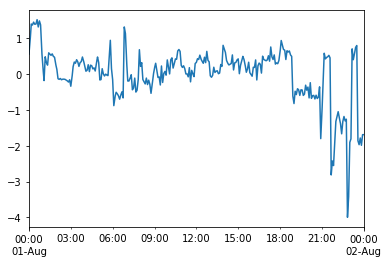

In [263]:
BR_final['r'].plot();

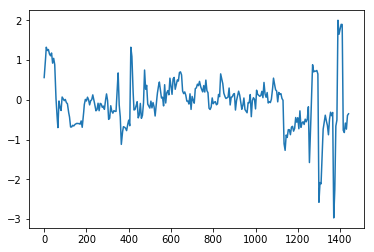

In [303]:
plt.plot(y);

In [267]:
np.hstack((0.,y))

array([ 0.        ,  0.55807149,  0.62666814, ..., -0.36902613,
       -0.36097607, -0.3529693 ])

In [17]:
w = 0.1*60
t = np.arange(1500)
ref_signal = np.sin(w*t)*1.5
#ref_signal = y
T = len(ref_signal)
Nb_particles = 25
lmbda = 0.06
gamma = 0.8
theta_max = 22.
theta_min = 18.
theta_on = 19.
kappa = 4.
rho = 0.8
application_params = {'Nb_particles': Nb_particles,'T': T,'theta_max': theta_max,'theta_min': theta_min,
                      'theta_on': theta_on,'kappa': kappa,'rho': rho,'lmbda': lmbda,'gamma': gamma}

BA = Balance_Authority(100,ref_signal,0.5,0.05,application_params,disaggregate=False)

In [6]:
BA.CS.set_transfer_func_params(zeta=0.)

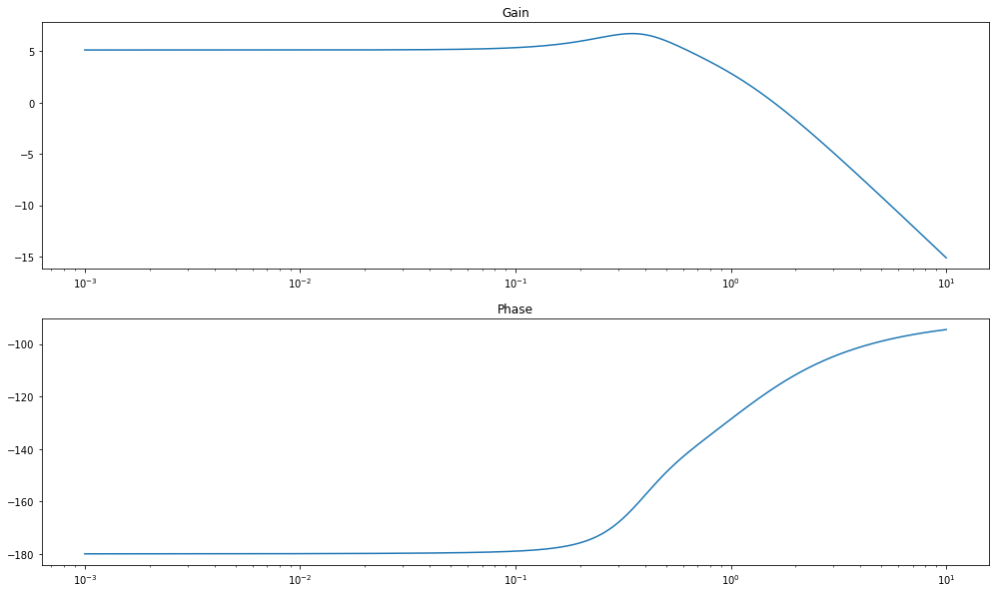

In [18]:
z_seq = np.logspace(-3,1,1000)
BA.CS.bode_plot(z_seq,'MF')

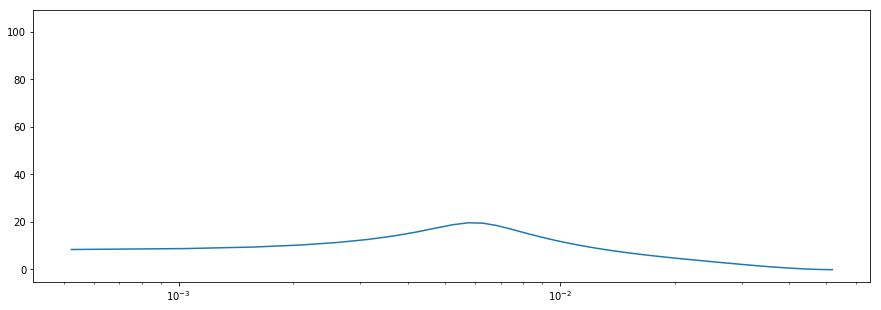

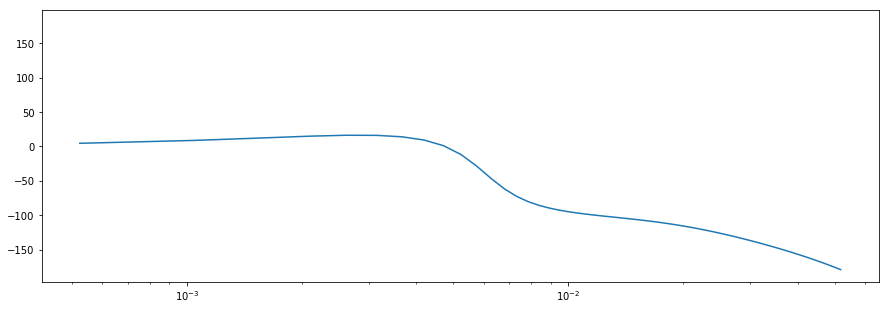

In [19]:
w, mag, phase = signal.dbode((BA.CS.A,BA.CS.B,BA.CS.C,0.,60))
plt.figure(figsize=(15,5))
plt.semilogx(w, mag)    # Bode magnitude plot
plt.figure(figsize=(15,5))
plt.semilogx(w, phase)  # Bode phase plot
plt.show()

In [20]:
f_c = 0.003
Kp = 0.6
Kirond = f_c/5. * Kp
Ki = 60 * Kirond
BA.CS.update_control_params(Kp=Kp,Ki=Ki)

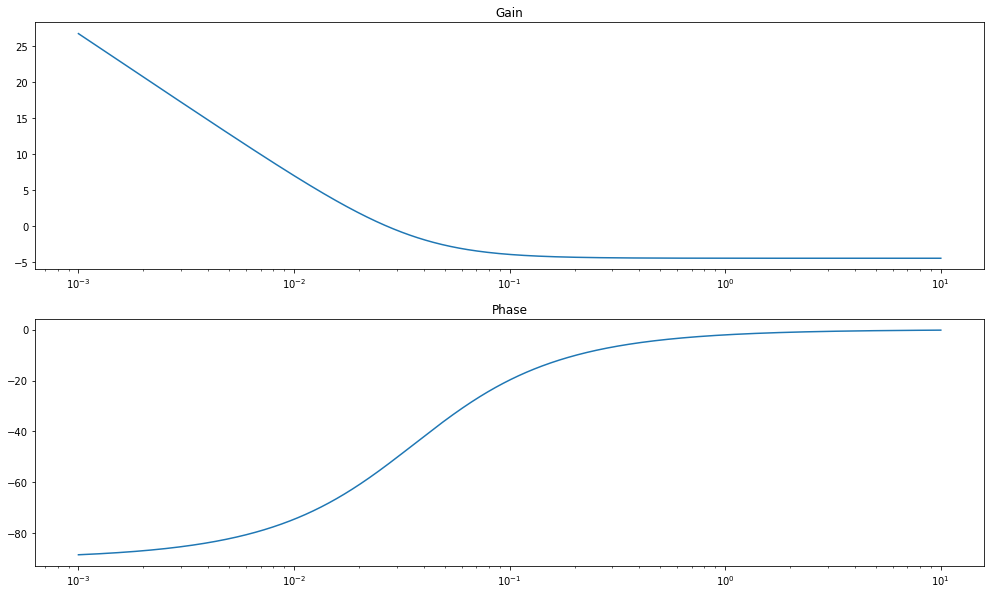

In [21]:
z_seq = np.logspace(-3,1,1000)
BA.CS.bode_plot(z_seq,'PI')

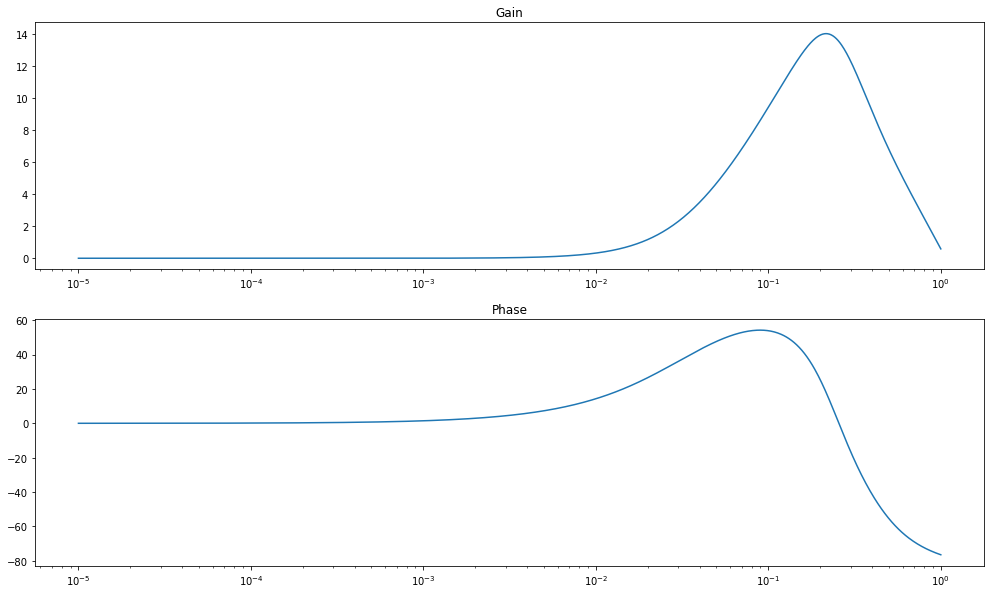

In [22]:
z_seq = np.logspace(-5,0,1000)
BA.CS.bode_plot(z_seq,'ClosedLoop')

In [23]:
BA.fit()

[ 1498/1499,    0.01sec avg,    0.01sec ETA ]      
   0.01sec avg,   11.62sec total



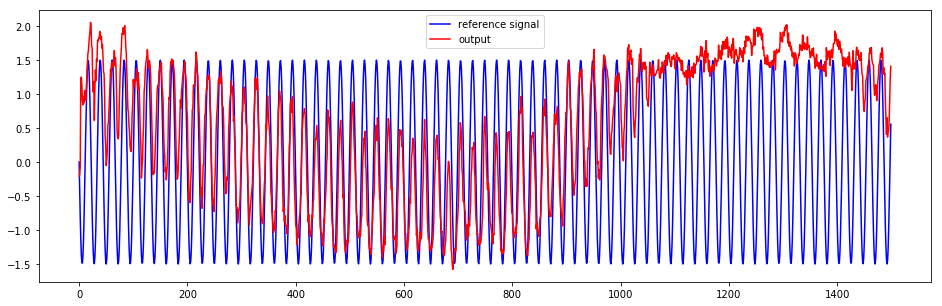

In [24]:
BA.plot()

In [162]:
Power_simulator.house

187

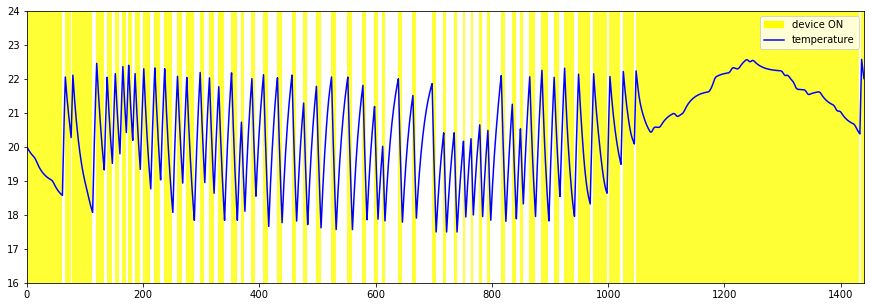

In [248]:
BA.DS_list[3].plot_behavior()

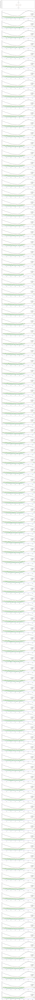

In [224]:
BA.plot_temp()

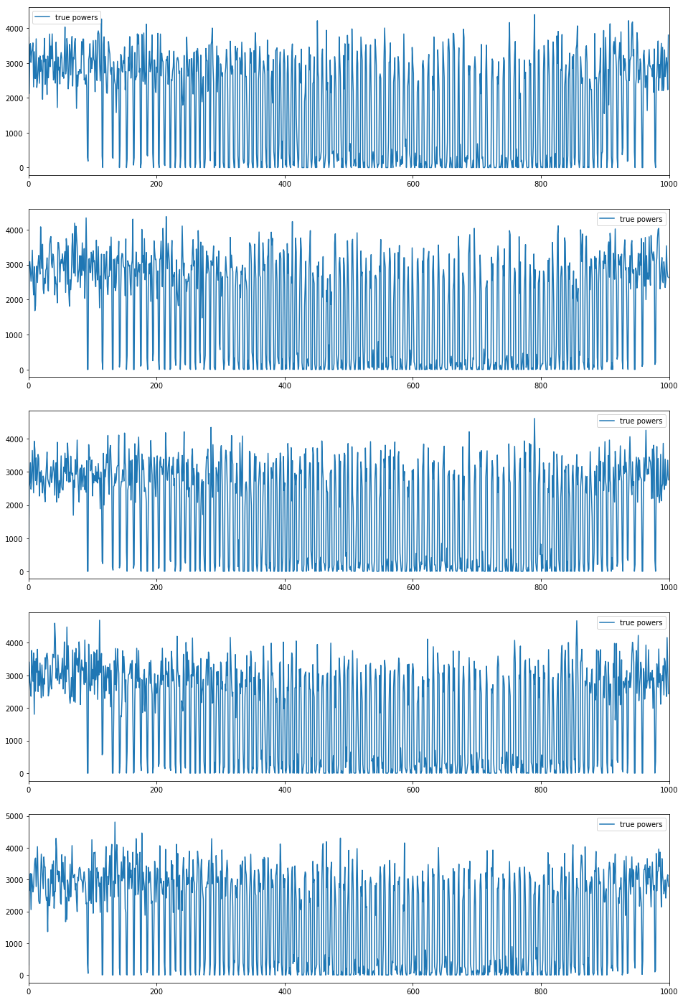

In [60]:
BA.plot_powers()

### With disaggregation

In [26]:
w = 0.1*60
t = np.arange(1440)
ref_signal = np.sin(w*t)*1.5
T = len(ref_signal)
Nb_particles = 25
lmbda = 0.06
gamma = 0.8
theta_max = 22.
theta_min = 18.
theta_on = 19.
kappa = 4.
rho = 0.8
application_params = {'Nb_particles': Nb_particles,'T': T,'theta_max': theta_max,'theta_min': theta_min,
                      'theta_on': theta_on,'kappa': kappa,'rho': rho,'lmbda': lmbda,'gamma': gamma}

BA = Balance_Authority(50,ref_signal,0.5,0.05,application_params,disaggregate=True)

In [27]:
BA.CS.set_transfer_func_params(zeta=0.)

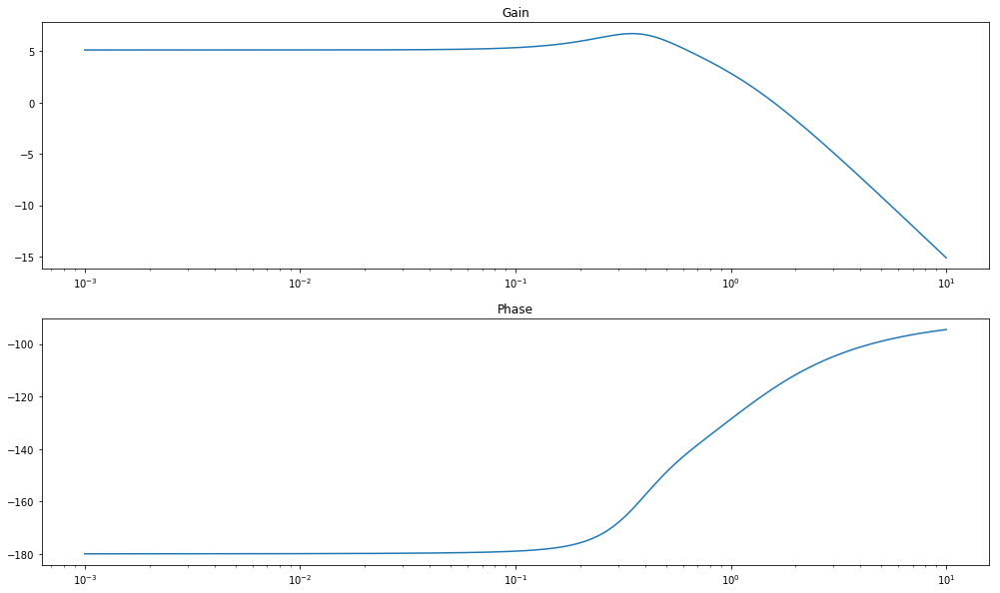

In [28]:
z_seq = np.logspace(-3,1,1000)
BA.CS.bode_plot(z_seq,'MF')

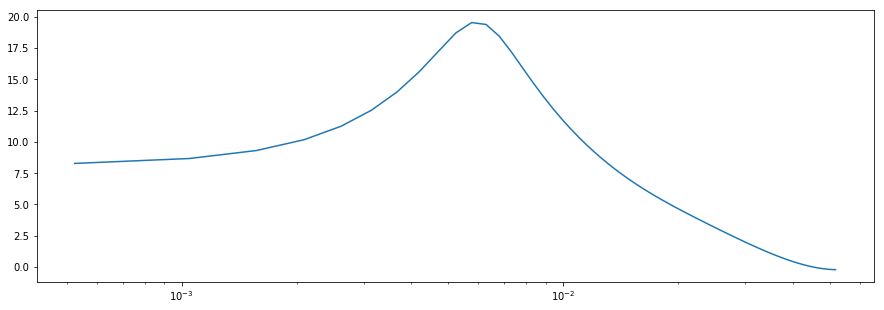

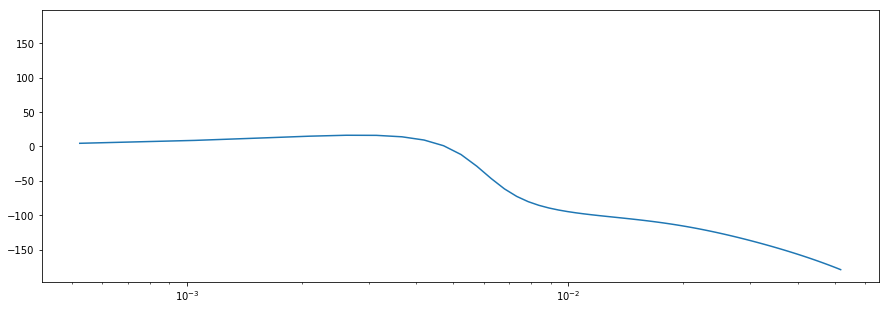

In [29]:
w, mag, phase = signal.dbode((BA.CS.A,BA.CS.B,BA.CS.C,0.,60))
plt.figure(figsize=(15,5))
plt.semilogx(w, mag)    # Bode magnitude plot
plt.figure(figsize=(15,5))
plt.semilogx(w, phase)  # Bode phase plot
plt.show()

In [30]:
f_c = 0.003
Kp = 0.6
Kirond = f_c/5. * Kp
Ki = 60 * Kirond
BA.CS.update_control_params(Kp=Kp,Ki=Ki)

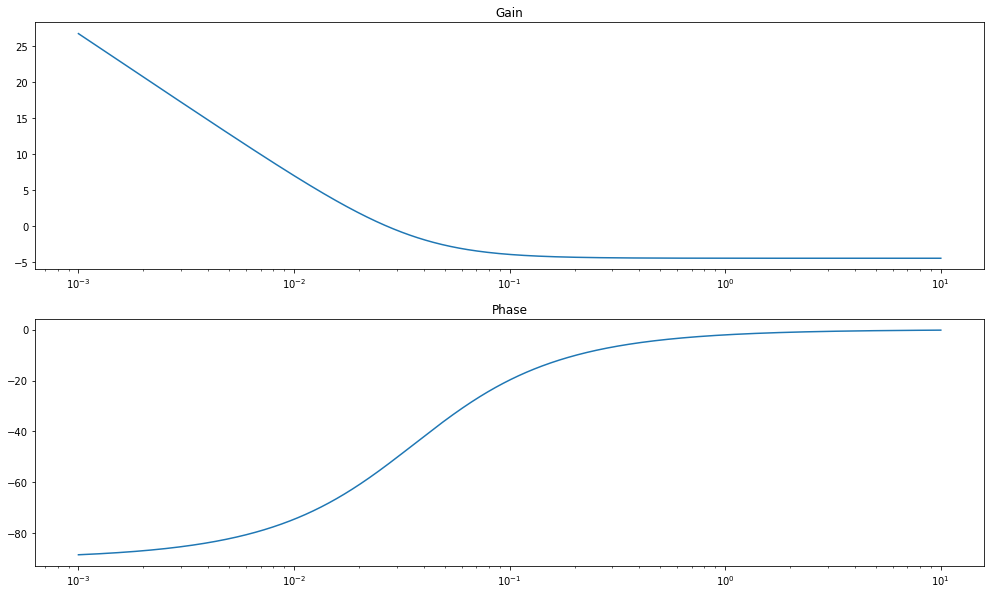

In [31]:
z_seq = np.logspace(-3,1,1000)
BA.CS.bode_plot(z_seq,'PI')

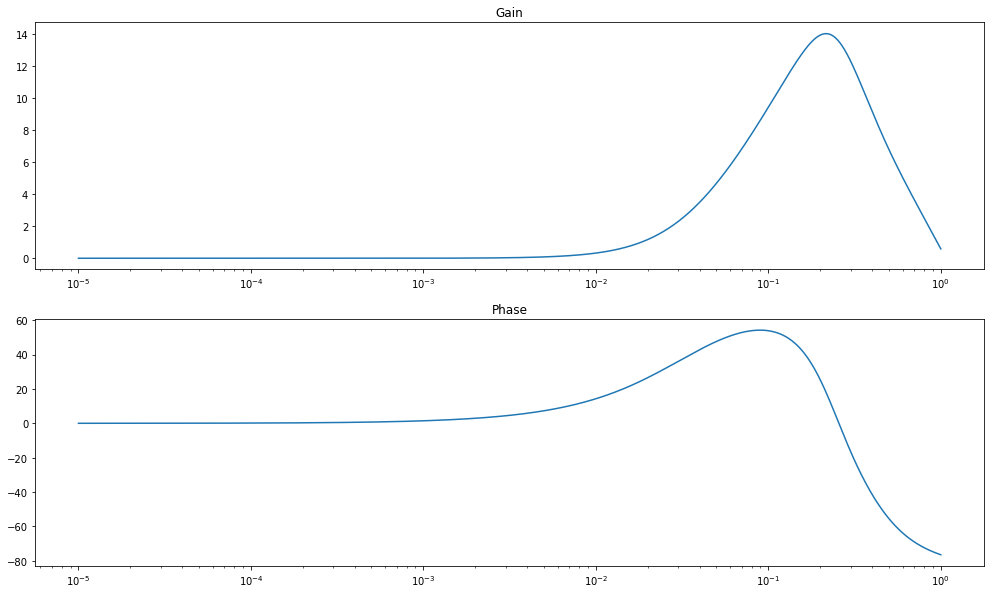

In [32]:
z_seq = np.logspace(-5,0,1000)
BA.CS.bode_plot(z_seq,'ClosedLoop')

In [33]:
BA.fit()

[ 1438/1439,    5.56sec avg,    5.56sec ETA ]      
   5.56sec avg, 7989.51sec total



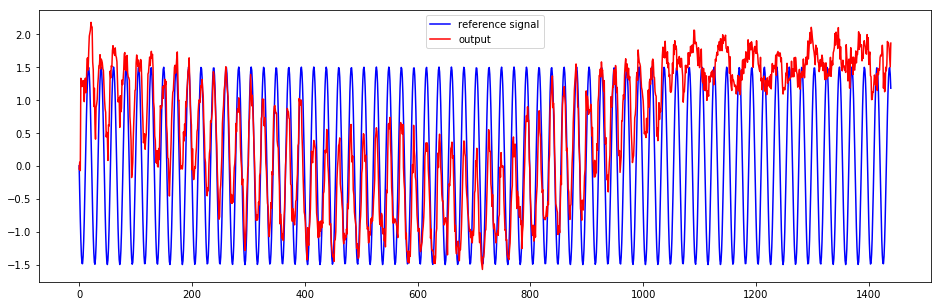

In [34]:
BA.plot()

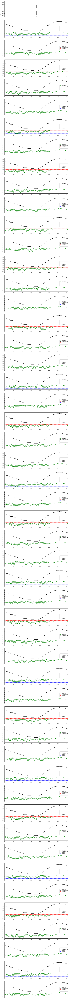

In [35]:
BA.plot_temp()

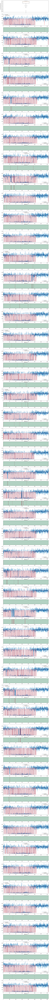

In [36]:
BA.plot_states()

### without control

In [165]:
w = 0.1 
t = np.arange(1500)
zeta_signal = np.sin(w*t)*0.00001
T = len(zeta_signal)
Nb_particles = 25
lmbda = 0.06
gamma = 0.8
theta_max = 22.
theta_min = 18.
theta_on = 19.
kappa = 4.
rho = 0.8
Nb_devices = 100
application_params = {'Nb_particles': Nb_particles,'T': T,'theta_max': theta_max,'theta_min': theta_min,
                      'theta_on': theta_on,'kappa': kappa,'rho': rho,'lmbda': lmbda,'gamma': gamma}

BA = Balance_Authority(Nb_devices,zeta_signal,0.5,0.05,application_params,disaggregate=False)

#def initiate(self):

BA.y[0] =  BA.total_power/1000. - BA.y[0]
        
# we send the signal to all disaggregation systems
BA.total_power = 0.
for DS in BA.DS_list:
    DS.initial_fit(0.)
    BA.total_power += DS.agg_power

for j in progprint(np.arange(1,T-1),T-1):
    # we compute the error
    BA.y[j] = BA.total_power/1000.  - BA.y[j]
        
    # we send the signal to all disaggregation systems
    BA.total_power = 0.
    for DS in BA.DS_list:
        DS.fit(0.)
        BA.total_power += DS.agg_power
                
# we compute the error
BA.y[T-1] = BA.total_power/1000. - BA.y[T-1]
        
# we send the signal to all disaggregation systems
for DS in BA.DS_list:
    DS.final_fit()
    
BA.y = BA.y/np.double(Nb_devices)

[ 1498/1499,    0.00sec avg,    0.00sec ETA ]      
   0.00sec avg,    6.37sec total



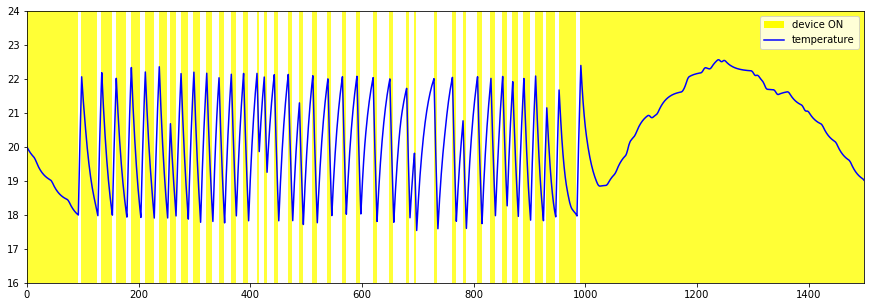

In [166]:
BA.DS_list[0].plot_behavior()

In [151]:
BA.CS.set_transfer_func_params(zeta=0.)

In [173]:
w = 0.1 
t = np.arange(1000)
zeta_signal = np.sin(w*t)*0.001
T = len(zeta_signal)
phi = np.zeros((2*5,T))
y = np.zeros(T)
for i, zeta in enumerate(zeta_signal[:(T-1)]):
    phi[:,i+1] = (np.dot(BA.CS.A,phi[:,i].reshape(-1,1)) + BA.CS.B * zeta).flatten()
    y[i+1] = np.dot(BA.CS.C,phi[:,i+1])

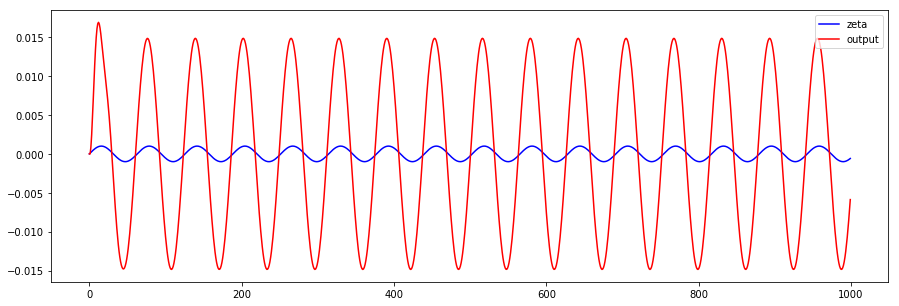

In [174]:
plt.figure(figsize=(15,5))
plt.plot(zeta_signal,color='blue',label='zeta')
plt.plot(y*5,color='red',label='output')
plt.legend(loc='best');

In [189]:
w = 0.1 
t = np.arange(1000)
zeta_signal = np.sin(w*t)*0.00001
T = len(zeta_signal)
Nb_particles = 25
lmbda = 0.06
gamma = 0.8
theta_max = 22.
theta_min = 18.
theta_on = 19.
kappa = 4.
rho = 0.8
Nb_devices = 100
application_params = {'Nb_particles': Nb_particles,'T': T,'theta_max': theta_max,'theta_min': theta_min,
                      'theta_on': theta_on,'kappa': kappa,'rho': rho,'lmbda': lmbda,'gamma': gamma}

BA = Balance_Authority(Nb_devices,zeta_signal,0.5,0.05,application_params,disaggregate=False)

#def initiate(self):

BA.y[0] =  BA.total_power/1000. - BA.y[0]
        
# we send the signal to all disaggregation systems
BA.total_power = 0.
for DS in BA.DS_list:
    DS.initial_fit(zeta_signal[0])
    BA.total_power += DS.agg_power

for j in progprint(np.arange(1,T-1),T-1):
    # we compute the error
    BA.y[j] = BA.total_power/1000.  - BA.y[j]
        
    # we send the signal to all disaggregation systems
    BA.total_power = 0.
    for DS in BA.DS_list:
        DS.fit(zeta_signal[j])
        BA.total_power += DS.agg_power
                
# we compute the error
BA.y[T-1] = BA.total_power/1000. - BA.y[T-1]
        
# we send the signal to all disaggregation systems
for DS in BA.DS_list:
    DS.final_fit()
    
BA.y = BA.y/np.double(Nb_devices)

[ 998/999,    0.01sec avg,    0.01sec ETA ]      
   0.01sec avg,    8.16sec total

